# IMPORT LIBRARY

In [1]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
plt.rcParams['figure.figsize'] = (10,5)
plt.rcParams['figure.dpi'] = 250
sns.set(style = 'darkgrid')
%matplotlib inline
from datetime import datetime
from sklearn.compose import ColumnTransformer
from sklearn.preprocessing import LabelEncoder, OneHotEncoder
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import GridSearchCV, train_test_split
from scipy.spatial.distance import pdist, squareform
from sklearn.svm import SVC
from sklearn.neighbors import KNeighborsClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.linear_model import LinearRegression
from sklearn.linear_model import LogisticRegression
from sklearn.ensemble import BaggingClassifier, RandomForestClassifier
from sklearn.ensemble import GradientBoostingClassifier, StackingClassifier
from xgboost import XGBClassifier
from sklearn.decomposition import PCA
from sklearn.neighbors import NearestNeighbors
from sklearn.metrics import classification_report, confusion_matrix
from sklearn.cluster import KMeans
from sklearn.cluster import DBSCAN
from scipy.cluster import hierarchy
from sklearn.cluster import AgglomerativeClustering
from sklearn.metrics import silhouette_score
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import accuracy_score
from sklearn.pipeline import Pipeline
from sklearn import set_config
set_config(display='diagram')
import warnings
warnings.filterwarnings('ignore')


# IMPORT DATASET

In [2]:
df = pd.read_excel("marketing_campaign11.xlsx")
df

,ID,Year_Birth,Education,Marital_Status,Income,Kidhome,Teenhome,Dt_Customer,Recency,MntWines,...,NumWebVisitsMonth,AcceptedCmp3,AcceptedCmp4,AcceptedCmp5,AcceptedCmp1,AcceptedCmp2,Complain,Z_CostContact,Z_Revenue,Response
0,5524,1957,Graduation,Single,58138.0,0,0,2012-09-04,58,635,...,7,0,0,0,0,0,0,3,11,1
1,2174,1954,Graduation,Single,46344.0,1,1,2014-03-08,38,11,...,5,0,0,0,0,0,0,3,11,0
2,4141,1965,Graduation,Together,71613.0,0,0,2013-08-21,26,426,...,4,0,0,0,0,0,0,3,11,0
3,6182,1984,Graduation,Together,26646.0,1,0,2014-02-10,26,11,...,6,0,0,0,0,0,0,3,11,0
4,5324,1981,PhD,Married,58293.0,1,0,2014-01-19,94,173,...,5,0,0,0,0,0,0,3,11,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2235,10870,1967,Graduation,Married,61223.0,0,1,2013-06-13,46,709,...,5,0,0,0,0,0,0,3,11,0
2236,4001,1946,PhD,Together,64014.0,2,1,2014-06-10,56,406,...,7,0,0,0,1,0,0,3,11,0
2237,7270,1981,Graduation,Divorced,56981.0,0,0,2014-01-25,91,908,...,6,0,1,0,0,0,0,3,11,0
2238,8235,1956,Master,Together,69245.0,0,1,2014-01-24,8,428,...,3,0,0,0,0,0,0,3,11,0


# EXPLORATORY DATA ANALYSIS  (EDA)

In [3]:
#display all rows and columns

In [4]:
pd.set_option('display.max_columns',None)
print(df)

         ID  Year_Birth   Education Marital_Status   Income  Kidhome  \
0      5524        1957  Graduation         Single  58138.0        0   
1      2174        1954  Graduation         Single  46344.0        1   
2      4141        1965  Graduation       Together  71613.0        0   
3      6182        1984  Graduation       Together  26646.0        1   
4      5324        1981         PhD        Married  58293.0        1   
...     ...         ...         ...            ...      ...      ...   
2235  10870        1967  Graduation        Married  61223.0        0   
2236   4001        1946         PhD       Together  64014.0        2   
2237   7270        1981  Graduation       Divorced  56981.0        0   
2238   8235        1956      Master       Together  69245.0        0   
2239   9405        1954         PhD        Married  52869.0        1   

      Teenhome Dt_Customer  Recency  MntWines  MntFruits  MntMeatProducts  \
0            0  2012-09-04       58       635         88  

In [5]:
pd.set_option('display.max_rows',None)
print(df)

         ID  Year_Birth   Education Marital_Status    Income  Kidhome  \
0      5524        1957  Graduation         Single   58138.0        0   
1      2174        1954  Graduation         Single   46344.0        1   
2      4141        1965  Graduation       Together   71613.0        0   
3      6182        1984  Graduation       Together   26646.0        1   
4      5324        1981         PhD        Married   58293.0        1   
5      7446        1967      Master       Together   62513.0        0   
6       965        1971  Graduation       Divorced   55635.0        0   
7      6177        1985         PhD        Married   33454.0        1   
8      4855        1974         PhD       Together   30351.0        1   
9      5899        1950         PhD       Together    5648.0        1   
10     1994        1983  Graduation        Married       NaN        1   
11      387        1976       Basic        Married    7500.0        0   
12     2125        1959  Graduation       Divorced 

In [6]:
#drop unneccesary column

In [7]:
df.columns

Index(['ID', 'Year_Birth', 'Education', 'Marital_Status', 'Income', 'Kidhome',
       'Teenhome', 'Dt_Customer', 'Recency', 'MntWines', 'MntFruits',
       'MntMeatProducts', 'MntFishProducts', 'MntSweetProducts',
       'MntGoldProds', 'NumDealsPurchases', 'NumWebPurchases',
       'NumCatalogPurchases', 'NumStorePurchases', 'NumWebVisitsMonth',
       'AcceptedCmp3', 'AcceptedCmp4', 'AcceptedCmp5', 'AcceptedCmp1',
       'AcceptedCmp2', 'Complain', 'Z_CostContact', 'Z_Revenue', 'Response'],
      dtype='object')

In [8]:
column = ['ID','Z_CostContact', 'Z_Revenue']

In [9]:
df.drop(columns= column,inplace = True )

In [10]:
#data shape
df.shape

(2240, 26)

In [11]:
df.dtypes

Year_Birth                      int64
Education                      object
Marital_Status                 object
Income                        float64
Kidhome                         int64
Teenhome                        int64
Dt_Customer            datetime64[ns]
Recency                         int64
MntWines                        int64
MntFruits                       int64
MntMeatProducts                 int64
MntFishProducts                 int64
MntSweetProducts                int64
MntGoldProds                    int64
NumDealsPurchases               int64
NumWebPurchases                 int64
NumCatalogPurchases             int64
NumStorePurchases               int64
NumWebVisitsMonth               int64
AcceptedCmp3                    int64
AcceptedCmp4                    int64
AcceptedCmp5                    int64
AcceptedCmp1                    int64
AcceptedCmp2                    int64
Complain                        int64
Response                        int64
dtype: objec

In [12]:
df.nunique()

Year_Birth               59
Education                 5
Marital_Status            8
Income                 1974
Kidhome                   3
Teenhome                  3
Dt_Customer             663
Recency                 100
MntWines                776
MntFruits               158
MntMeatProducts         558
MntFishProducts         182
MntSweetProducts        177
MntGoldProds            213
NumDealsPurchases        15
NumWebPurchases          15
NumCatalogPurchases      14
NumStorePurchases        14
NumWebVisitsMonth        16
AcceptedCmp3              2
AcceptedCmp4              2
AcceptedCmp5              2
AcceptedCmp1              2
AcceptedCmp2              2
Complain                  2
Response                  2
dtype: int64

In [13]:
#describe categorial columns
df.describe(include = object)

,Education,Marital_Status
count,2240,2240
unique,5,8
top,Graduation,Married
freq,1127,864


In [14]:
#describing other columns
df.describe()

,Year_Birth,Income,Kidhome,Teenhome,Dt_Customer,Recency,MntWines,MntFruits,MntMeatProducts,MntFishProducts,MntSweetProducts,MntGoldProds,NumDealsPurchases,NumWebPurchases,NumCatalogPurchases,NumStorePurchases,NumWebVisitsMonth,AcceptedCmp3,AcceptedCmp4,AcceptedCmp5,AcceptedCmp1,AcceptedCmp2,Complain,Response
count,2240.000000,2216.000000,2240.000000,2240.000000,2240,2240.000000,2240.000000,2240.000000,2240.000000,2240.000000,2240.000000,2240.000000,2240.000000,2240.000000,2240.000000,2240.000000,2240.000000,2240.000000,2240.000000,2240.000000,2240.000000,2240.000000,2240.000000,2240.000000
mean,1968.805804,52247.251354,0.444196,0.506250,2013-07-10 10:01:42.857142784,49.109375,303.935714,26.302232,166.950000,37.525446,27.062946,44.021875,2.325000,4.084821,2.662054,5.790179,5.316518,0.072768,0.074554,0.072768,0.064286,0.013393,0.009375,0.149107
min,1893.000000,1730.000000,0.000000,0.000000,2012-07-30 00:00:00,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
25%,1959.000000,35303.000000,0.000000,0.000000,2013-01-16 00:00:00,24.000000,23.750000,1.000000,16.000000,3.000000,1.000000,9.000000,1.000000,2.000000,0.000000,3.000000,3.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
50%,1970.000000,51381.500000,0.000000,0.000000,2013-07-08 12:00:00,49.000000,173.500000,8.000000,67.000000,12.000000,8.000000,24.000000,2.000000,4.000000,2.000000,5.000000,6.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
75%,1977.000000,68522.000000,1.000000,1.000000,2013-12-30 06:00:00,74.000000,504.250000,33.000000,232.000000,50.000000,33.000000,56.000000,3.000000,6.000000,4.000000,8.000000,7.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
max,1996.000000,666666.000000,2.000000,2.000000,2014-06-29 00:00:00,99.000000,1493.000000,199.000000,1725.000000,259.000000,263.000000,362.000000,15.000000,27.000000,28.000000,13.000000,20.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
std,11.984069,25173.076661,0.538398,0.544538,NaN,28.962453,336.597393,39.773434,225.715373,54.628979,41.280498,52.167439,1.932238,2.778714,2.923101,3.250958,2.426645,0.259813,0.262728,0.259813,0.245316,0.114976,0.096391,0.356274


In [15]:
#duplicates value
df.duplicated().sum()

182

In [16]:
df.drop_duplicates(inplace = True)

In [17]:
df.duplicated().sum()

0

In [18]:
#dataset information
df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 2058 entries, 0 to 2239
Data columns (total 26 columns):
 #   Column               Non-Null Count  Dtype         
---  ------               --------------  -----         
 0   Year_Birth           2058 non-null   int64         
 1   Education            2058 non-null   object        
 2   Marital_Status       2058 non-null   object        
 3   Income               2034 non-null   float64       
 4   Kidhome              2058 non-null   int64         
 5   Teenhome             2058 non-null   int64         
 6   Dt_Customer          2058 non-null   datetime64[ns]
 7   Recency              2058 non-null   int64         
 8   MntWines             2058 non-null   int64         
 9   MntFruits            2058 non-null   int64         
 10  MntMeatProducts      2058 non-null   int64         
 11  MntFishProducts      2058 non-null   int64         
 12  MntSweetProducts     2058 non-null   int64         
 13  MntGoldProds         2058 non-null   i

# Missing Value Imputation

         1) If NA values are between 1 to 5%, drop na (rows).
         2) If NA values are between 5 to 40%, fillna(replace).
         3) If NA values are greater than 50% , drop the entire column.

In [19]:
df.isnull().sum()

Year_Birth              0
Education               0
Marital_Status          0
Income                 24
Kidhome                 0
Teenhome                0
Dt_Customer             0
Recency                 0
MntWines                0
MntFruits               0
MntMeatProducts         0
MntFishProducts         0
MntSweetProducts        0
MntGoldProds            0
NumDealsPurchases       0
NumWebPurchases         0
NumCatalogPurchases     0
NumStorePurchases       0
NumWebVisitsMonth       0
AcceptedCmp3            0
AcceptedCmp4            0
AcceptedCmp5            0
AcceptedCmp1            0
AcceptedCmp2            0
Complain                0
Response                0
dtype: int64

In [20]:
#calculate the missing values for each column
for i in df.isna().sum():
    print(i/len(df) *100)

0.0
0.0
0.0
1.1661807580174928
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0
0.0


In [21]:
#Visualization of missing values

<Axes: >

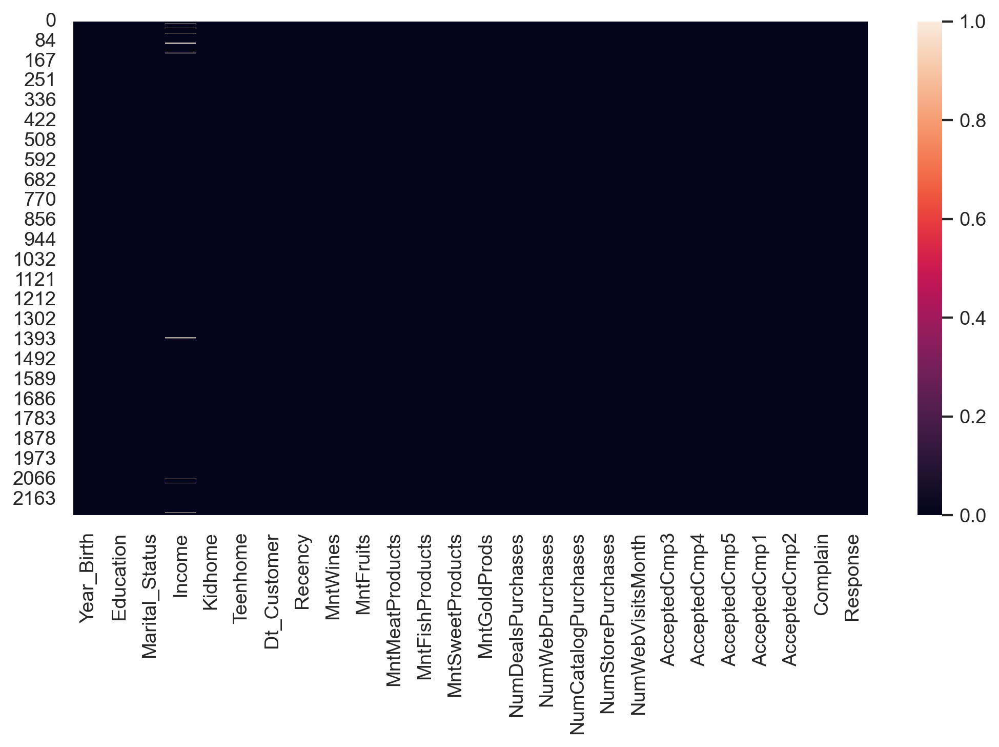

In [22]:
sns.heatmap(df.isnull())

In [23]:
#fill missing values

In [24]:
df['Income'] = df['Income'].fillna(0)  # Replace NaN values with 0
df['Income'] = df['Income'].astype(int)  # Convert the column to integer data type

In [25]:
df['Income']=df['Income'].fillna(df['Income'].median())

In [26]:
df.isnull().sum()

Year_Birth             0
Education              0
Marital_Status         0
Income                 0
Kidhome                0
Teenhome               0
Dt_Customer            0
Recency                0
MntWines               0
MntFruits              0
MntMeatProducts        0
MntFishProducts        0
MntSweetProducts       0
MntGoldProds           0
NumDealsPurchases      0
NumWebPurchases        0
NumCatalogPurchases    0
NumStorePurchases      0
NumWebVisitsMonth      0
AcceptedCmp3           0
AcceptedCmp4           0
AcceptedCmp5           0
AcceptedCmp1           0
AcceptedCmp2           0
Complain               0
Response               0
dtype: int64

# DATA VISUALIZATION

In [27]:
# NULL VALUE

<Axes: >

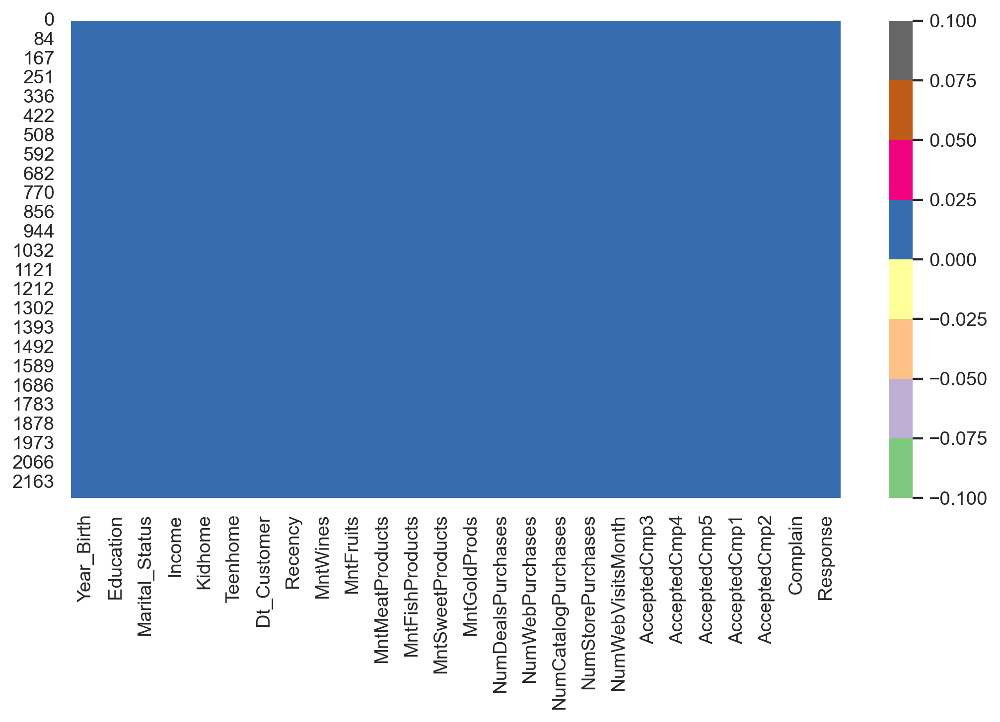

In [28]:
sns.heatmap(df.isnull(), cmap = 'Accent')

# Correlation

In [33]:
numeric_columns = df.select_dtypes(include=['number']).columns
print("Numeric columns:", numeric_columns)


Numeric columns: Index(['Year_Birth', 'Income', 'Kidhome', 'Teenhome', 'Recency', 'MntWines',
       'MntFruits', 'MntMeatProducts', 'MntFishProducts', 'MntSweetProducts',
       'MntGoldProds', 'NumDealsPurchases', 'NumWebPurchases',
       'NumCatalogPurchases', 'NumStorePurchases', 'NumWebVisitsMonth',
       'AcceptedCmp3', 'AcceptedCmp4', 'AcceptedCmp5', 'AcceptedCmp1',
       'AcceptedCmp2', 'Complain', 'Response'],
      dtype='object')


In [34]:
df_numeric = df[numeric_columns]
correlation_matrix = df_numeric.corr()

Text(0.5, 1.0, 'Correlation Heatmap')

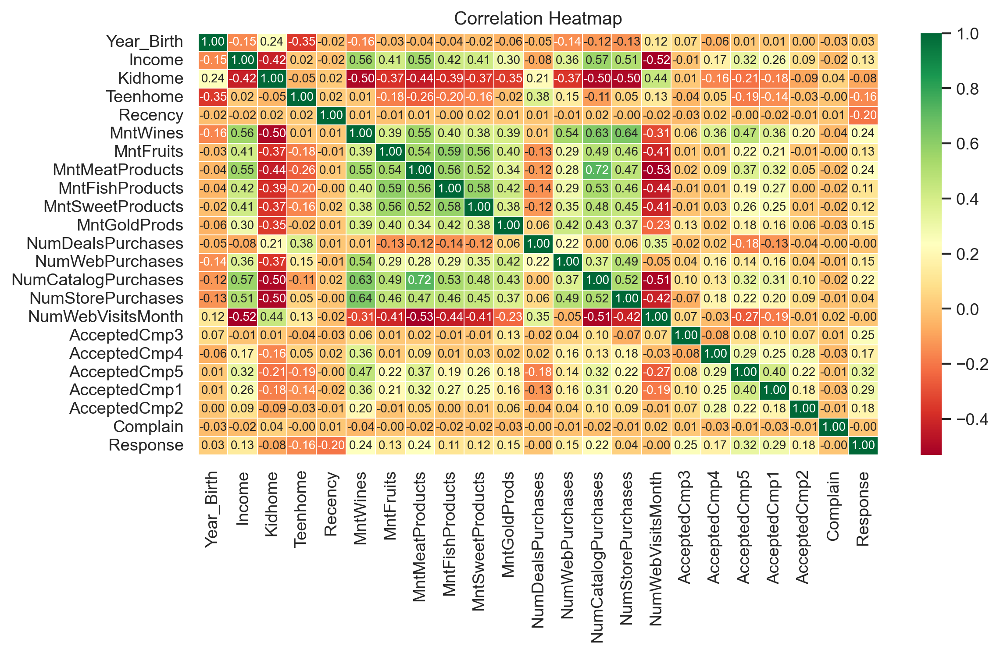

In [35]:
sns.heatmap(df_numeric.corr(), annot=True,cmap = 'RdYlGn', fmt=".2f",linewidths=0.5, annot_kws={"size": 8})
plt.title('Correlation Heatmap')

# Histogram 

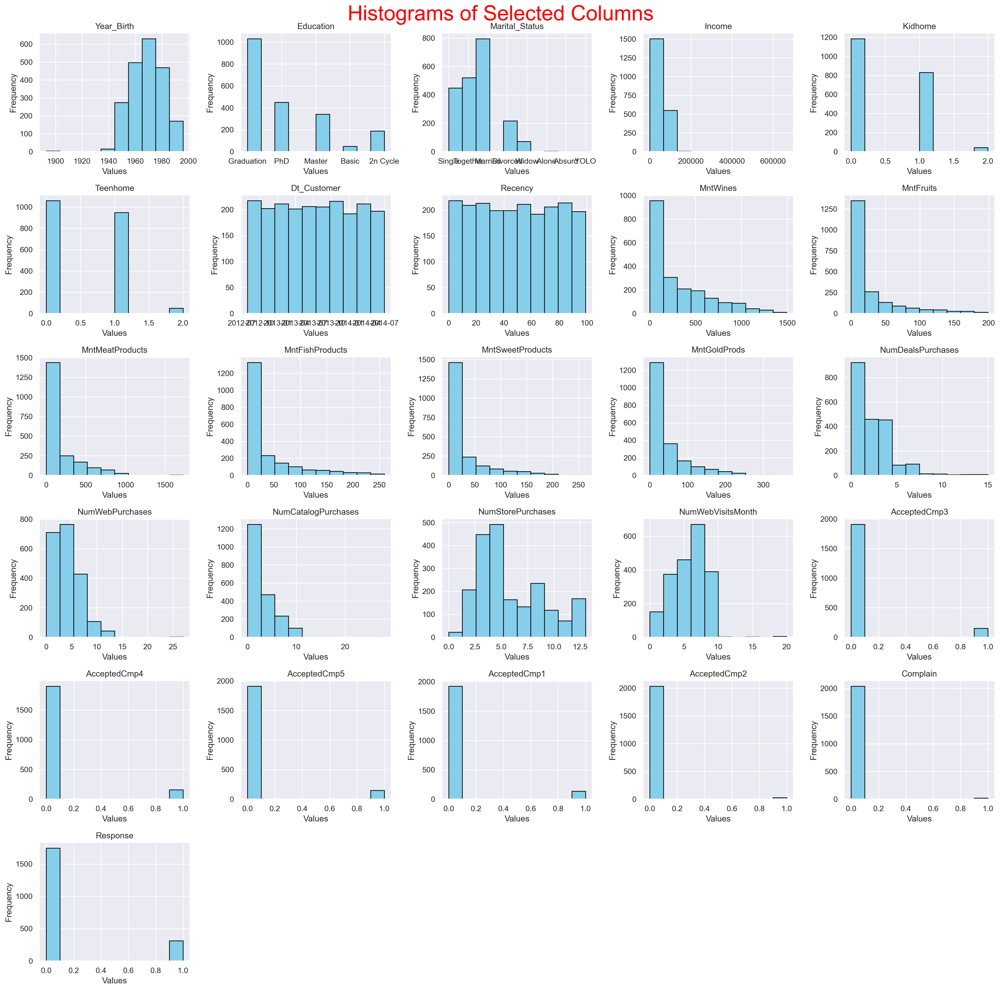

In [37]:
df = pd.DataFrame(df)

# Set up the figure and axis
fig, axs = plt.subplots(6, 5, figsize=(20, 20))
fig.suptitle('Histograms of Selected Columns', fontsize = 30, color = 'red')

# Flatten the axis array for easy iteration
axs = axs.flatten()

# Iterate through each column and plot histogram
for i, column in enumerate(df.columns):
    axs[i].hist(df[column], bins=10, color='skyblue', edgecolor='black')
    axs[i].set_title(column)
    axs[i].set_xlabel('Values')
    axs[i].set_ylabel('Frequency')

# Hide any unused subplots
for j in range(len(df.columns), len(axs)):
    axs[j].axis('off')

# Adjust layout
plt.tight_layout()
plt.show()

# Boxplot

# outlier detection 

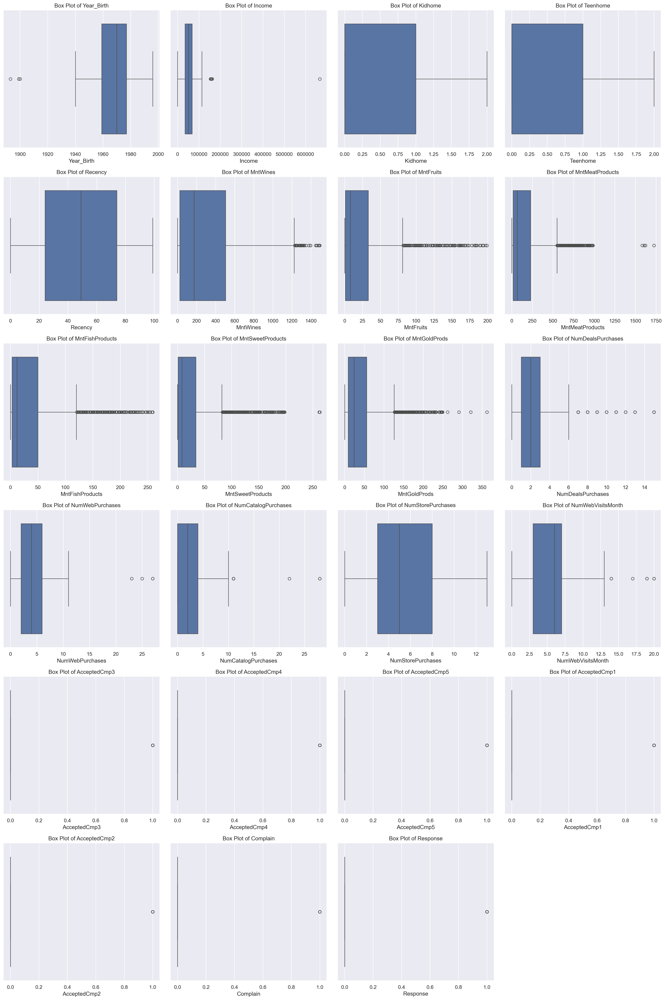

In [38]:
# Get the numerical column names
numerical_columns = df.select_dtypes(include=['int', 'float']).columns.tolist()

# Calculate the number of rows and columns for subplots
num_plots = len(numerical_columns)
num_rows = (num_plots - 1) // 4 + 1
num_cols = min(num_plots, 4)

# Create box plots for multiple numerical columns
plt.figure(figsize=(5 * num_cols, 5 * num_rows))
for i, column in enumerate(numerical_columns, 1):
    plt.subplot(num_rows, num_cols, i)
    sns.boxplot(data=df, x=column)
    plt.title(f'Box Plot of {column}')
    plt.xlabel(column)
plt.tight_layout()

In [39]:
df.columns

Index(['Year_Birth', 'Education', 'Marital_Status', 'Income', 'Kidhome',
       'Teenhome', 'Dt_Customer', 'Recency', 'MntWines', 'MntFruits',
       'MntMeatProducts', 'MntFishProducts', 'MntSweetProducts',
       'MntGoldProds', 'NumDealsPurchases', 'NumWebPurchases',
       'NumCatalogPurchases', 'NumStorePurchases', 'NumWebVisitsMonth',
       'AcceptedCmp3', 'AcceptedCmp4', 'AcceptedCmp5', 'AcceptedCmp1',
       'AcceptedCmp2', 'Complain', 'Response'],
      dtype='object')

In [40]:
columns = ['Year_Birth', 'Income', 'Kidhome', 'Teenhome',
       'Recency', 'MntWines', 'MntFruits', 'MntMeatProducts',
       'MntFishProducts', 'MntSweetProducts', 'MntGoldProds',
       'NumDealsPurchases', 'NumWebPurchases', 'NumCatalogPurchases',
       'NumStorePurchases', 'NumWebVisitsMonth', 'AcceptedCmp3',
       'AcceptedCmp4', 'AcceptedCmp5', 'AcceptedCmp1', 'AcceptedCmp2',
       'Complain', 'Response']

In [41]:
def outlier_detection(data,colname):
    for col in colname:
        q1 = data[col].quantile(0.25)
        q3 = data[col].quantile(0.75)
        iqr = q3-q1
    
        upper = q3+(1.5*iqr)
        lower = q1-(1.5*iqr)
    
        df[col]=np.where(df[col]> upper,upper,np.where(df[col]< lower,lower,df[col]))

In [42]:
outlier_detection(df, columns)

# After Removing Outlier

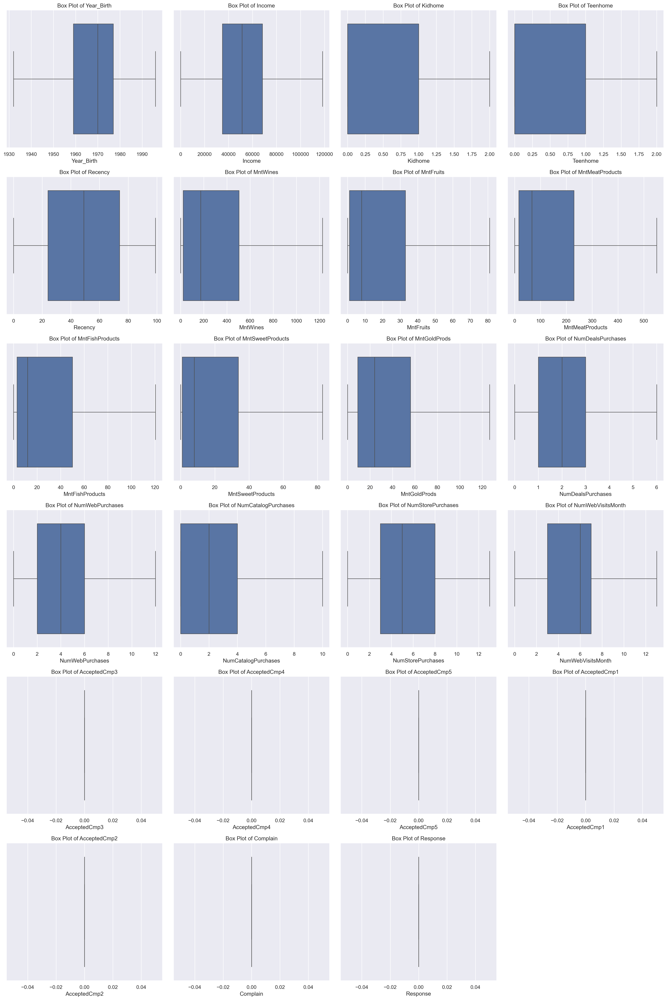

In [43]:
# Get the numerical column names
numerical_columns = df.select_dtypes(include=['int', 'float']).columns.tolist()

# Calculate the number of rows and columns for subplots
num_plots = len(numerical_columns)
num_rows = (num_plots - 1) // 4 + 1
num_cols = min(num_plots, 4)

# Create box plots for multiple numerical columns
plt.figure(figsize=(5 * num_cols, 5 * num_rows))
for i, column in enumerate(numerical_columns, 1):
    plt.subplot(num_rows, num_cols, i)
    sns.boxplot(data=df, x=column)
    plt.title(f'Box Plot of {column}')
    plt.xlabel(column)
plt.tight_layout()

# Barplot

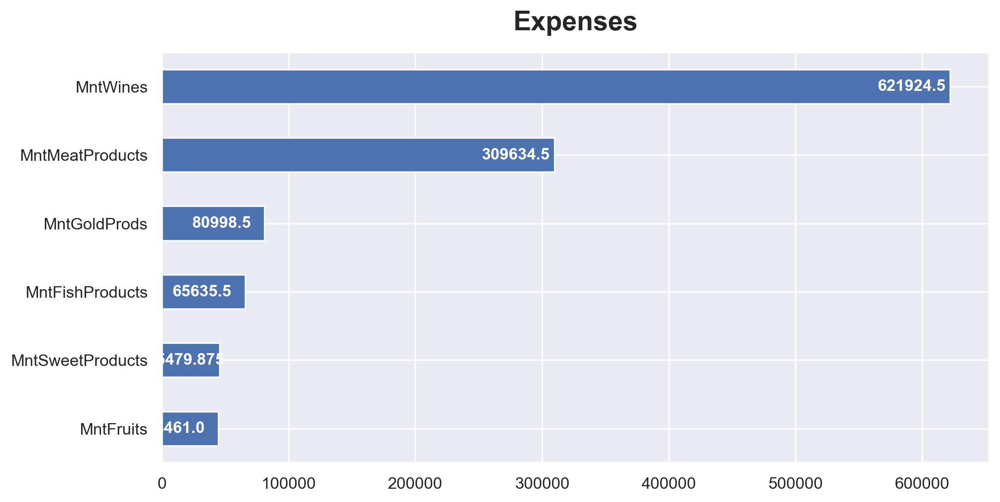

In [44]:
ax = df[['MntWines', 'MntFruits', 'MntMeatProducts', 'MntFishProducts', 'MntSweetProducts', 'MntGoldProds']].sum().sort_values(ascending=True).plot(kind='barh')
plt.title('Expenses', pad=15, fontsize=18, fontweight='semibold')
rects = ax.patches
for rect in rects:
    
    x_value = rect.get_width()
    y_value = rect.get_y() + rect.get_height() / 2
    
    plt.annotate('{}'.format(x_value), (x_value, y_value), xytext=(-49, 0),
textcoords='offset points', va='center', ha='left', color = 'white', fontsize=11, fontweight='semibold')

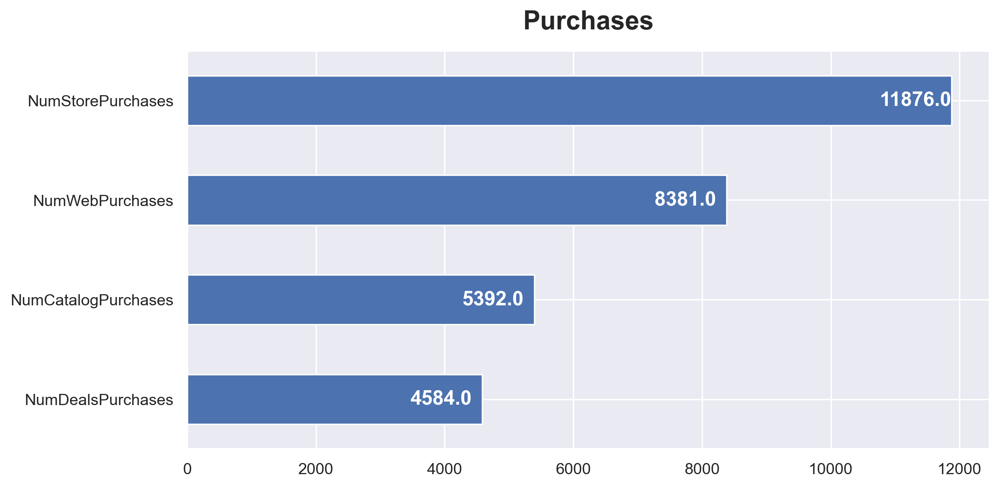

In [45]:
ax = df[['NumDealsPurchases', 'NumWebPurchases', 'NumCatalogPurchases', 'NumStorePurchases']].sum().sort_values(ascending=True).plot(kind='barh')
plt.title('Purchases', pad=15, fontsize=18, fontweight='semibold')
rects = ax.patches
for rect in rects:
    x_value = rect.get_width()
    y_value = rect.get_y() + rect.get_height() / 2
    plt.annotate('{}'.format(x_value), (x_value, y_value), xytext=(-50, 0),
textcoords='offset points', va='center', ha='left', color = 'white', fontsize=14, fontweight='semibold')

# Countplot

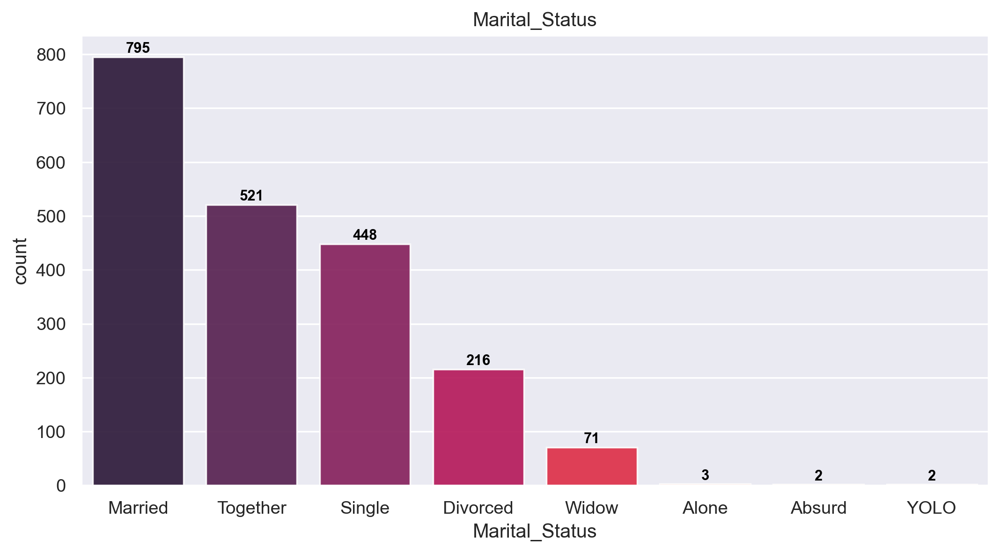

In [46]:
sns.set(style='darkgrid')

ax = sns.countplot(data=df, x='Marital_Status', saturation=1, alpha=0.9, palette='rocket', 
                   order=df['Marital_Status'].value_counts().index)

ax.set_title('Marital_Status')

for p in ax.patches:
    
    number = '{}'.format(p.get_height().astype('int64'))
    
    ax.annotate(number, (p.get_x() + p.get_width()/2., p.get_height()), ha='center', va='center',
    xytext=(0,5), textcoords='offset points', color='black', fontweight='semibold', fontsize=9)

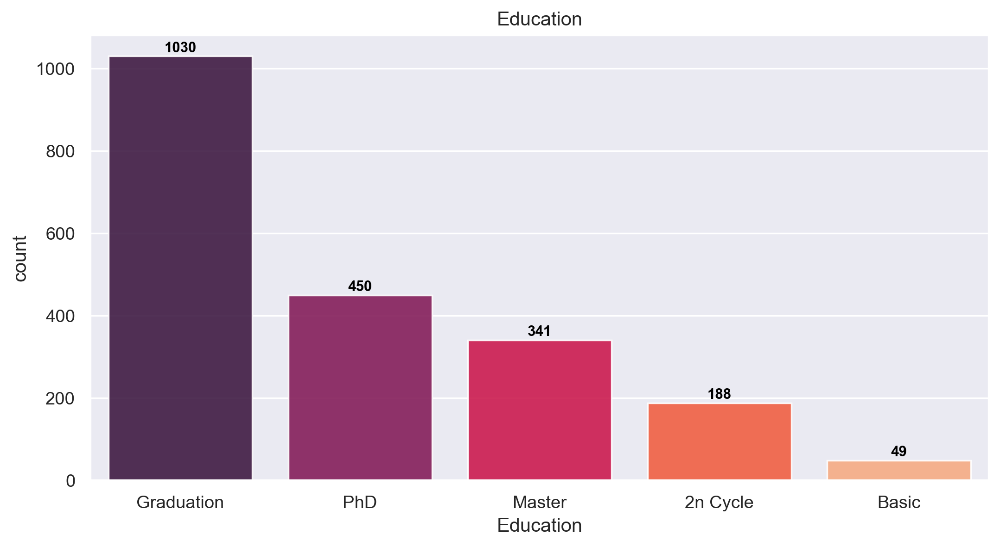

In [47]:
sns.set(style='darkgrid')

ax = sns.countplot(data=df, x='Education', saturation=1, alpha=0.9, palette='rocket', 
                   order=df['Education'].value_counts().index)

ax.set_title('Education')

for p in ax.patches:
    
    number = '{}'.format(p.get_height().astype('int64'))
    
    ax.annotate(number, (p.get_x() + p.get_width()/2., p.get_height()), ha='center', va='center',
    xytext=(0,5), textcoords='offset points', color='black', fontweight='semibold', fontsize=9)

# Combining different dataframe into a single column to reduce the number of dimension

In [48]:
df['Age'] = 2015 - df["Year_Birth"]

df['Kids'] = df['Kidhome'] + df['Teenhome']

df['Expenses'] = df['MntWines'] + df['MntFruits'] + df['MntMeatProducts'] + df['MntFishProducts'] + df['MntSweetProducts'] + df['MntGoldProds']

df['TotalAcceptedCmp'] = df['AcceptedCmp1'] + df['AcceptedCmp2'] + df['AcceptedCmp3'] + df['AcceptedCmp4'] + df['AcceptedCmp5'] + df['Response']

df['NumTotalPurchases'] = df['NumWebPurchases'] + df['NumCatalogPurchases'] + df['NumStorePurchases'] + df['NumDealsPurchases']

In [49]:
df.drop(columns=['Year_Birth','Dt_Customer'], inplace=True)

Text(0.5, 1.0, 'Age')

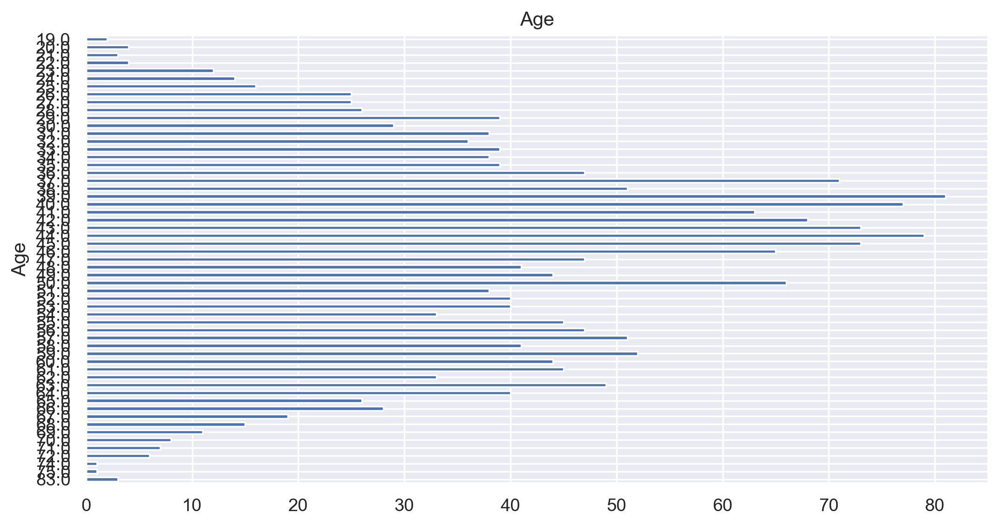

In [50]:
df['Age'].value_counts().sort_index(ascending=False).plot(kind='barh')
plt.title('Age')

Text(0.5, 1.0, 'Income')

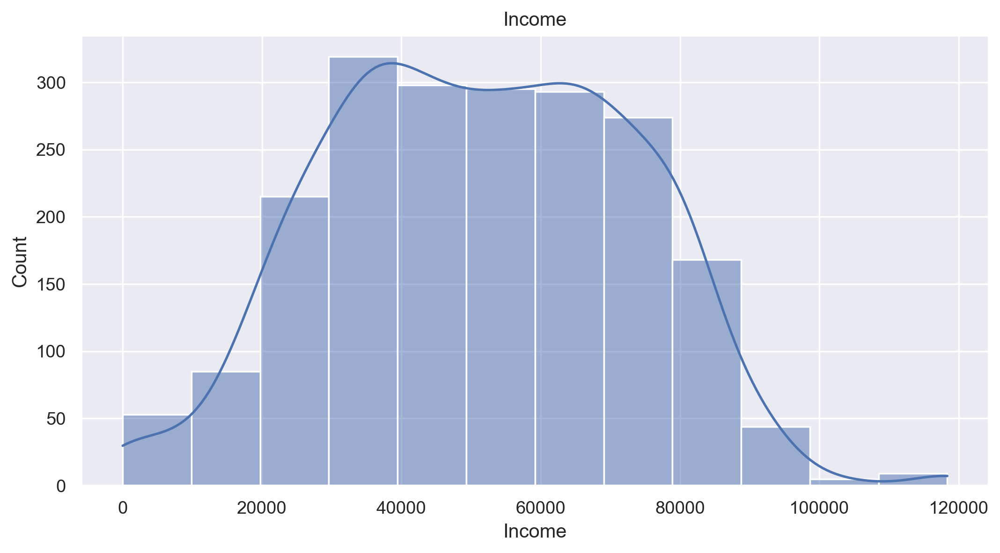

In [51]:
sns.histplot(data=df, x='Income', binwidth=10000, kde=True)
plt.title('Income')

# Pie Chart

In [ ]:
sizes = df['Complain'].value_counts()

# Ensure that the labels match the unique values in the 'Complain' column
labels = sizes.index.map({0: 'No Complain', 1: 'Complain'})

# Create the pie chart
fig, ax = plt.subplots()
ax.pie(sizes, labels=labels, autopct='%1.1f%%', shadow=True, 
       wedgeprops={'edgecolor': 'black'}, colors=['#3185fc','#F5F5F5'])
ax.axis('equal')  # Equal aspect ratio ensures that pie is drawn as a circle
ax.set_title('Complain raised by the customer')

# Show the plot
plt.show()

# Scatterplot

<Axes: xlabel='Marital_Status', ylabel='Income'>

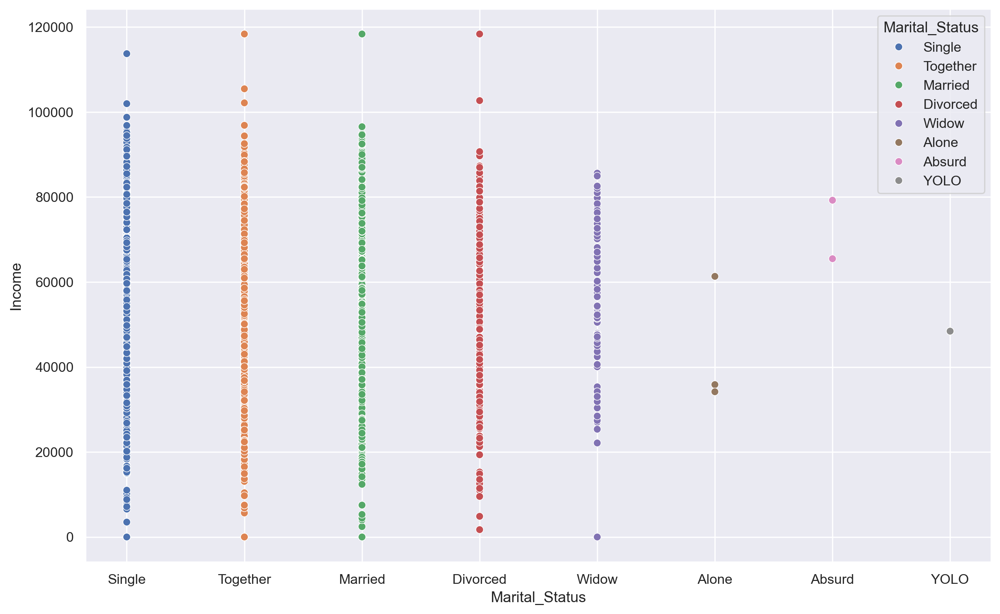

In [52]:
plt.figure(figsize=(13,8))
sns.scatterplot(x=df['Marital_Status'], y=df['Income'], hue = df['Marital_Status'])

<Axes: xlabel='Education', ylabel='Income'>

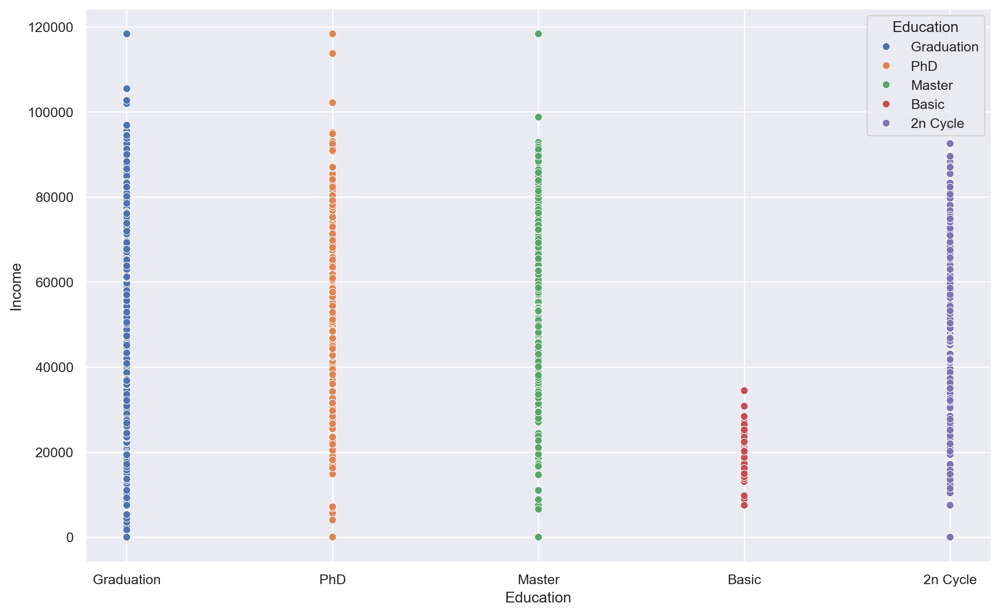

In [53]:
plt.figure(figsize=(13,8))
sns.scatterplot(x=df['Education'], y=df['Income'], hue =df['Education'])

# Pairplot

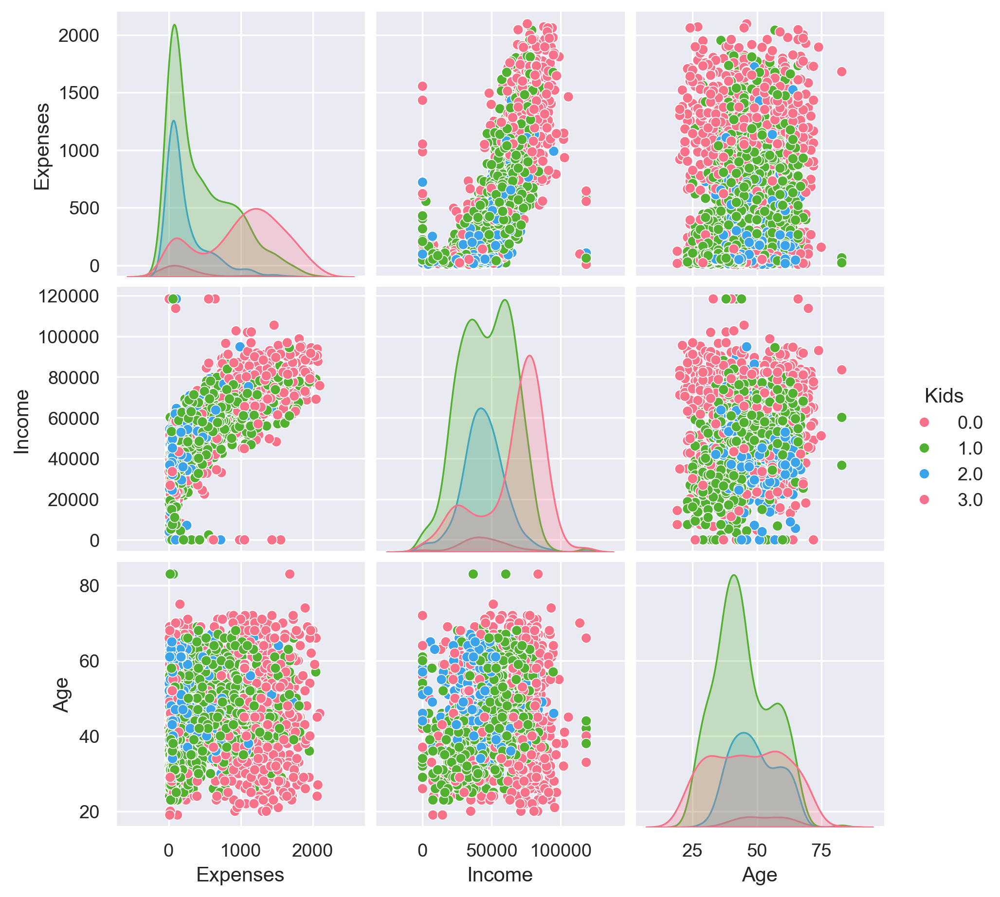

In [56]:
sns.pairplot(df , vars=['Expenses','Income','Age'] , hue='Kids', palette='husl')

In [57]:
df.head()

,Education,Marital_Status,Income,Kidhome,Teenhome,Recency,MntWines,MntFruits,MntMeatProducts,MntFishProducts,MntSweetProducts,MntGoldProds,NumDealsPurchases,NumWebPurchases,NumCatalogPurchases,NumStorePurchases,NumWebVisitsMonth,AcceptedCmp3,AcceptedCmp4,AcceptedCmp5,AcceptedCmp1,AcceptedCmp2,Complain,Response,Age,Kids,Expenses,TotalAcceptedCmp,NumTotalPurchases
0,Graduation,Single,58138.0,0.0,0.0,58.0,635.0,81.0,546.0,120.5,82.875,88.0,3.0,8.0,10.0,4.0,7.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,58.0,0.0,1553.375,0.0,25.0
1,Graduation,Single,46344.0,1.0,1.0,38.0,11.0,1.0,6.0,2.0,1.000,6.0,2.0,1.0,1.0,2.0,5.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,61.0,2.0,27.000,0.0,6.0
2,Graduation,Together,71613.0,0.0,0.0,26.0,426.0,49.0,127.0,111.0,21.000,42.0,1.0,8.0,2.0,10.0,4.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,50.0,0.0,776.000,0.0,21.0
3,Graduation,Together,26646.0,1.0,0.0,26.0,11.0,4.0,20.0,10.0,3.000,5.0,2.0,2.0,0.0,4.0,6.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,31.0,1.0,53.000,0.0,8.0
4,PhD,Married,58293.0,1.0,0.0,94.0,173.0,43.0,118.0,46.0,27.000,15.0,5.0,5.0,3.0,6.0,5.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,34.0,1.0,422.000,0.0,19.0


# Encoding for (categorial column)

In [58]:
# Initialize LabelEncoder
le = LabelEncoder()

# Encode 'Column1' and 'Column2'
df['Education'] = le.fit_transform(df['Education'])
df['Marital_Status'] = le.fit_transform(df['Marital_Status'])

# scailng (on data)

In [59]:
sc = StandardScaler()
X= sc.fit_transform(df)
X

array([[-0.35151587,  0.25979158,  0.313223  , ...,  1.80561107,
         0.        ,  1.3843397 ],
       [-0.35151587,  0.25979158, -0.23066535, ..., -0.99021694,
         0.        , -1.16693762],
       [-0.35151587,  1.18961954,  0.93463182, ...,  0.38171013,
         0.        ,  0.84722869],
       ...,
       [-0.35151587, -1.59986433,  0.25986716, ...,  1.23344055,
         0.        ,  0.57867318],
       [ 0.53502783,  1.18961954,  0.82542989, ...,  0.50443258,
         0.        ,  1.11578419],
       [ 1.42157152, -0.67003637,  0.07023947, ..., -0.72462359,
         0.        , -0.49554885]])

In [60]:
pd.DataFrame(X, columns = df.columns)

,Education,Marital_Status,Income,Kidhome,Teenhome,Recency,MntWines,MntFruits,MntMeatProducts,MntFishProducts,MntSweetProducts,MntGoldProds,NumDealsPurchases,NumWebPurchases,NumCatalogPurchases,NumStorePurchases,NumWebVisitsMonth,AcceptedCmp3,AcceptedCmp4,AcceptedCmp5,AcceptedCmp1,AcceptedCmp2,Complain,Response,Age,Kids,Expenses,TotalAcceptedCmp,NumTotalPurchases
0,-0.351516,0.259792,0.313223,-0.829097,-0.932051,0.312088,1.004720,2.185418,2.216715,2.200534,2.172280,1.220624,0.501951,1.479459,2.703573,-0.546780,0.721693,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.008357,-1.275744,1.805611,0.0,1.384340
1,-0.351516,0.259792,-0.230665,1.031625,0.898255,-0.377754,-0.879122,-0.758103,-0.809548,-0.742381,-0.754132,-0.837081,-0.147744,-1.157320,-0.593476,-1.164383,-0.127746,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.263902,1.396501,-0.990217,0.0,-1.166938
2,-0.351516,1.189620,0.934632,-0.829097,-0.932051,-0.791659,0.373754,1.008009,-0.131441,1.964604,-0.039283,0.066301,-0.797440,1.479459,-0.227137,1.306029,-0.552466,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.326903,-1.275744,0.381710,0.0,0.847229
3,-0.351516,1.189620,-1.139052,1.031625,-0.932051,-0.791659,-0.879122,-0.647721,-0.731089,-0.543703,-0.682647,-0.862175,-0.147744,-0.780637,-0.959815,-0.546780,0.296974,0.0,0.0,0.0,0.0,0.0,0.0,0.0,-1.291551,0.060379,-0.942593,0.0,-0.898382
4,1.421572,-0.670036,0.320371,1.031625,-0.932051,1.553804,-0.390047,0.787245,-0.181879,0.350347,0.175171,-0.611236,1.801342,0.349411,0.139202,0.070823,-0.127746,0.0,0.0,0.0,0.0,0.0,0.0,0.0,-1.036006,0.060379,-0.266704,0.0,0.578673
5,0.535028,1.189620,0.514979,-0.829097,0.898255,-1.136580,0.657538,0.750451,-0.293963,-0.792050,0.711308,-0.636330,-0.147744,0.726093,0.505540,1.306029,0.296974,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.156539,0.060379,0.271809,0.0,0.981506
6,-0.351516,-1.599864,0.197795,-0.829097,0.898255,-0.515722,-0.202871,1.596714,0.075914,0.449686,0.961505,-0.310108,1.151647,1.102776,0.139202,0.379625,0.296974,0.0,0.0,0.0,0.0,0.0,0.0,0.0,-0.184188,0.060379,0.041018,0.0,0.847229
7,1.421572,-0.670036,-0.825096,1.031625,-0.932051,-0.584707,-0.682888,-0.426957,-0.529339,-0.717546,-0.754132,-0.410484,-0.147744,-0.027272,-0.959815,-0.546780,1.146413,0.0,0.0,0.0,0.0,0.0,0.0,0.0,-1.376733,0.060379,-0.730119,0.0,-0.629827
8,1.421572,1.189620,-0.968193,1.031625,-0.932051,-1.033104,-0.870065,-0.794897,-0.708673,-0.717546,-0.682647,-0.937457,-0.797440,-0.403955,-0.959815,-1.164383,1.571132,0.0,0.0,0.0,0.0,0.0,0.0,0.0,-0.439733,0.060379,-0.955415,0.0,-1.166938
9,1.421572,1.189620,-2.107389,1.031625,0.898255,0.657009,-0.827799,-0.794897,-0.809548,-0.767216,-0.754132,-0.661424,-0.797440,-1.157320,-0.959815,-1.781986,3.270011,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.604630,1.396501,-0.949920,0.0,-1.704049


In [61]:
pca = PCA(n_components=2)
x = pca.fit_transform(X)

# Clustering

# 1. Hierarchy Cluster

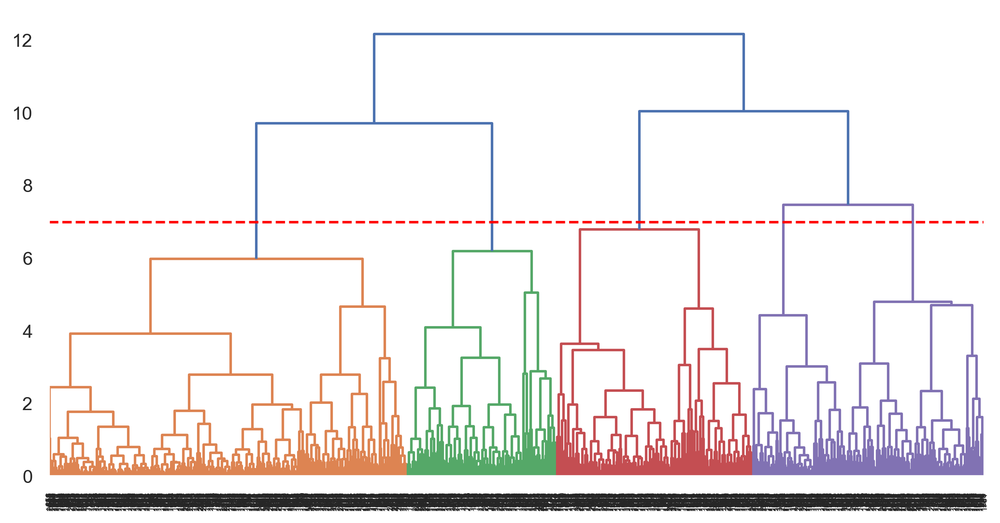

In [65]:
lk = hierarchy.linkage(x, method='complete')
dendrogram = hierarchy.dendrogram(lk)
plt.axhline(y = 7, linestyle = '--', color = 'red')

# Model Building

In [66]:
hc = AgglomerativeClustering(n_clusters = 4)

ypred = hc.fit_predict(x)
ypred

array([1, 0, 1, ..., 2, 1, 0], dtype=int64)

In [67]:
df['cluster'] = ypred


In [68]:
df['cluster'].value_counts()

cluster
0    893
2    410
3    378
1    377
Name: count, dtype: int64

In [69]:
df.groupby('cluster').agg('mean')

,Education,Marital_Status,Income,Kidhome,Teenhome,Recency,MntWines,MntFruits,MntMeatProducts,MntFishProducts,MntSweetProducts,MntGoldProds,NumDealsPurchases,NumWebPurchases,NumCatalogPurchases,NumStorePurchases,NumWebVisitsMonth,AcceptedCmp3,AcceptedCmp4,AcceptedCmp5,AcceptedCmp1,AcceptedCmp2,Complain,Response,Age,Kids,Expenses,TotalAcceptedCmp,NumTotalPurchases
cluster,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
0,2.253080,3.705487,33343.114222,0.800672,0.432251,49.096305,34.742441,4.424412,21.236842,6.087346,4.554171,13.871221,1.902576,1.997760,0.474804,3.075028,6.415454,0.0,0.0,0.0,0.0,0.0,0.0,0.0,43.103024,1.232923,84.916433,0.0,7.450168
1,2.567639,3.705570,65415.363395,0.106101,0.856764,50.562334,640.957560,37.716180,229.324934,53.469496,37.673077,68.347480,2.986737,7.047745,4.705570,9.084881,5.164456,0.0,0.0,0.0,0.0,0.0,0.0,0.0,50.946950,0.962865,1067.488727,0.0,23.824934
2,2.385366,3.778049,75934.978049,0.012195,0.009756,49.417073,576.893902,51.075610,412.870122,79.497561,52.562500,63.840244,1.002439,4.607317,5.804878,8.121951,2.407317,0.0,0.0,0.0,0.0,0.0,0.0,0.0,45.543902,0.021951,1236.739939,0.0,19.536585
3,2.576720,3.708995,53173.275132,0.415344,0.886243,46.500000,298.232804,14.153439,92.427910,19.702381,14.972553,44.100529,3.566138,5.425926,2.153439,6.283069,5.941799,0.0,0.0,0.0,0.0,0.0,0.0,0.0,49.288360,1.301587,483.589616,0.0,17.428571


# calculate silhouette score

In [ ]:
silhouette_score(x,ypred)

# visualization cluster

In [ ]:
sns.scatterplot(x=x[:, 0], y=x[:, 1], hue=df['cluster'], palette='rainbow')
plt.show()

# 2. K-Means

In [ ]:
sns.scatterplot(x=x[:, 0], y=x[:, 1])

# Calculate and plot the mean of the two columns in X
plt.scatter(x[:, 0].mean(), x[:, 1].mean(), color='red')

plt.show()

# model for k-means

In [71]:
km = KMeans()

yp = km.fit_predict(x)
yp

array([1, 4, 5, ..., 5, 2, 4])

In [72]:
km.cluster_centers_

array([[ 1.197805  ,  0.8007095 ],
       [ 4.78699542, -1.19135312],
       [ 3.03142845,  1.85878051],
       [-2.86176902, -1.43281043],
       [-3.09856331,  0.68362365],
       [ 2.94682455, -1.4195936 ],
       [-0.47325984,  2.58865892],
       [-1.02493979, -0.08251004]])

# visualization cluster

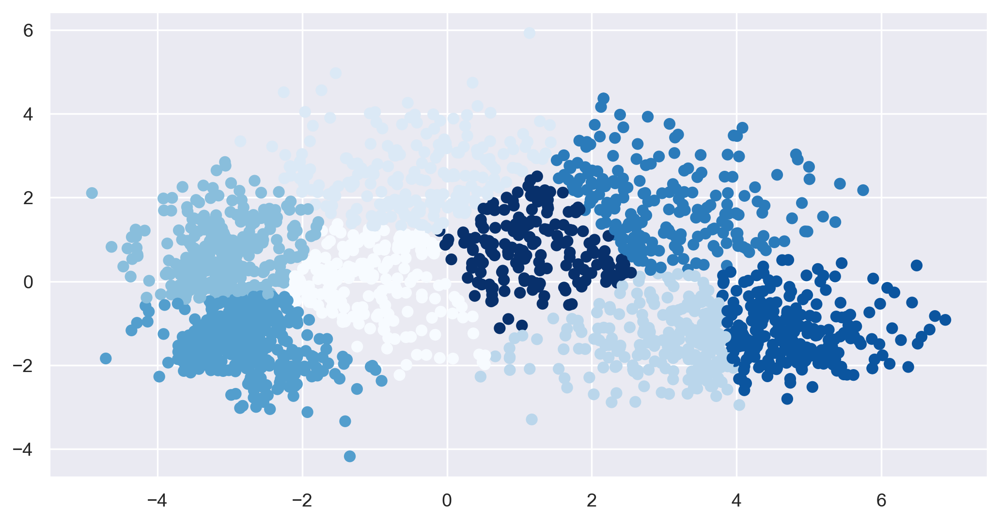

In [74]:
plt.scatter(x= x[:,0], y = x[:,1], c = yp, cmap = 'Blues_r')

In [75]:
km.inertia_

2083.4594945215385

In [76]:
#final model

In [77]:
km = KMeans(n_clusters = 4)

ypred = km.fit_predict(x)
ypred

array([1, 3, 1, ..., 1, 0, 3])

In [78]:
km.cluster_centers_

array([[ 1.59241209,  1.68825671],
       [ 3.91974637, -1.15048637],
       [-2.71142133, -1.18719976],
       [-2.09831026,  1.19437674]])

In [79]:
#visualize cluster

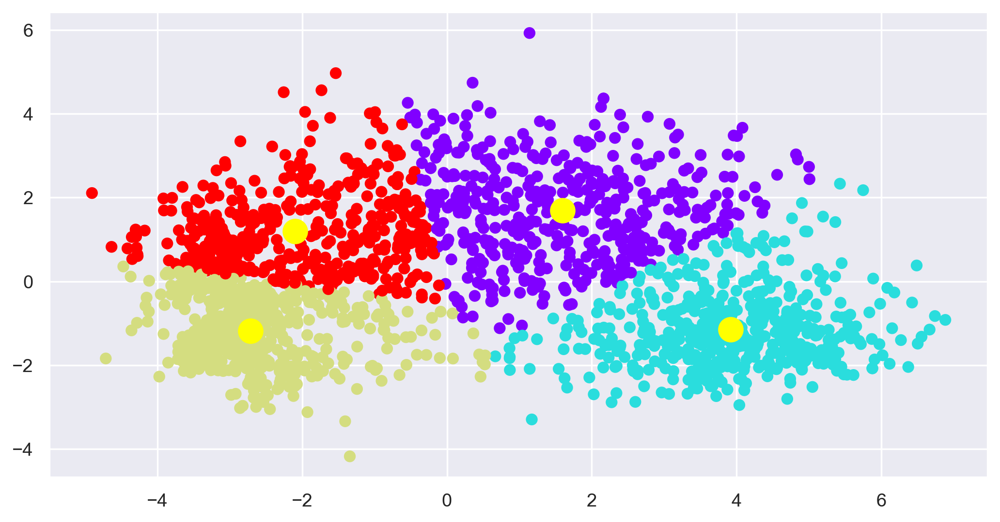

In [80]:
plt.scatter(x[:, 0], x[:, 1], c=ypred, cmap='rainbow')  # Plot data points
plt.scatter(km.cluster_centers_[:, 0], km.cluster_centers_[:, 1], c='yellow', s=200)

In [81]:
km.inertia_

4077.0903222003103

In [82]:
#Evaluation the model
silhouette_score(x, ypred)

0.4227950745088539

In [83]:
df.groupby('cluster').agg('mean')

,Education,Marital_Status,Income,Kidhome,Teenhome,Recency,MntWines,MntFruits,MntMeatProducts,MntFishProducts,MntSweetProducts,MntGoldProds,NumDealsPurchases,NumWebPurchases,NumCatalogPurchases,NumStorePurchases,NumWebVisitsMonth,AcceptedCmp3,AcceptedCmp4,AcceptedCmp5,AcceptedCmp1,AcceptedCmp2,Complain,Response,Age,Kids,Expenses,TotalAcceptedCmp,NumTotalPurchases
cluster,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
0,2.253080,3.705487,33343.114222,0.800672,0.432251,49.096305,34.742441,4.424412,21.236842,6.087346,4.554171,13.871221,1.902576,1.997760,0.474804,3.075028,6.415454,0.0,0.0,0.0,0.0,0.0,0.0,0.0,43.103024,1.232923,84.916433,0.0,7.450168
1,2.567639,3.705570,65415.363395,0.106101,0.856764,50.562334,640.957560,37.716180,229.324934,53.469496,37.673077,68.347480,2.986737,7.047745,4.705570,9.084881,5.164456,0.0,0.0,0.0,0.0,0.0,0.0,0.0,50.946950,0.962865,1067.488727,0.0,23.824934
2,2.385366,3.778049,75934.978049,0.012195,0.009756,49.417073,576.893902,51.075610,412.870122,79.497561,52.562500,63.840244,1.002439,4.607317,5.804878,8.121951,2.407317,0.0,0.0,0.0,0.0,0.0,0.0,0.0,45.543902,0.021951,1236.739939,0.0,19.536585
3,2.576720,3.708995,53173.275132,0.415344,0.886243,46.500000,298.232804,14.153439,92.427910,19.702381,14.972553,44.100529,3.566138,5.425926,2.153439,6.283069,5.941799,0.0,0.0,0.0,0.0,0.0,0.0,0.0,49.288360,1.301587,483.589616,0.0,17.428571


In [84]:
df['cluster'].value_counts()

cluster
0    893
2    410
3    378
1    377
Name: count, dtype: int64

# 3.DBSCAN

In [85]:
#model building

In [86]:
db = DBSCAN(eps = 0.1, min_samples = 2)

y = db.fit_predict(x)
y

array([ -1,   0,  -1, ..., 205,  75,  34], dtype=int64)

In [87]:
#Visualize cluster

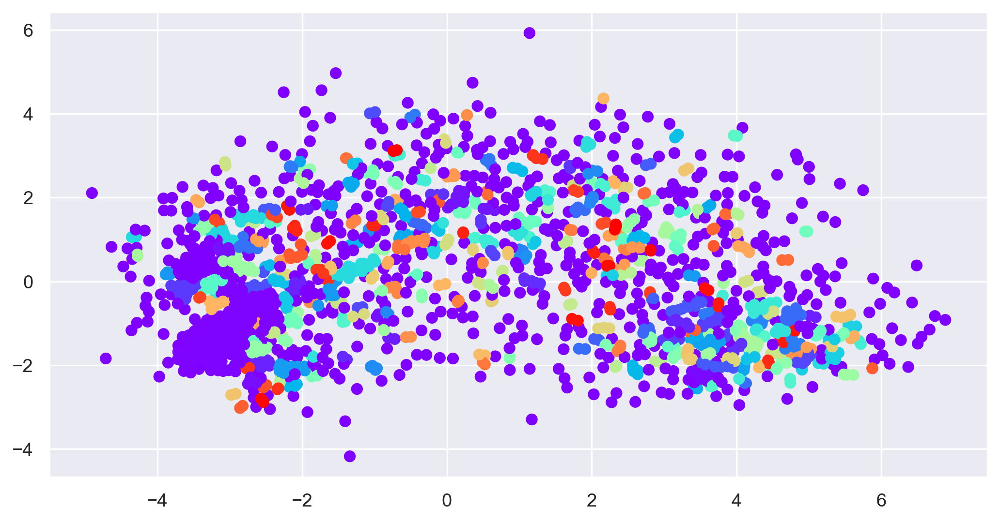

In [88]:
plt.scatter(x[:,0], x[:,1], c = y, cmap = 'rainbow')

In [89]:
silhouette_score(x,y)

-0.06382841078003035

In [90]:
#HyperParameter Tunning

In [91]:
neigh = NearestNeighbors(n_neighbors=3).fit(x)
neigh.kneighbors(x)

(array([[0.        , 0.21549132, 0.28396656],
        [0.        , 0.03420801, 0.08504043],
        [0.        , 0.16563425, 0.19511175],
        ...,
        [0.        , 0.08027124, 0.08108407],
        [0.        , 0.06242768, 0.07686361],
        [0.        , 0.08692623, 0.12326781]]),
 array([[   0, 1368,  417],
        [   1, 1356, 1737],
        [   2,  131,  162],
        ...,
        [2055, 1542,  768],
        [2056, 1396,  217],
        [2057,  105, 1187]], dtype=int64))

In [92]:
d,index= neigh.kneighbors(x)
d

array([[0.        , 0.21549132, 0.28396656],
       [0.        , 0.03420801, 0.08504043],
       [0.        , 0.16563425, 0.19511175],
       ...,
       [0.        , 0.08027124, 0.08108407],
       [0.        , 0.06242768, 0.07686361],
       [0.        , 0.08692623, 0.12326781]])

In [93]:
distance = np.sort(d[:,1])
distance

array([0.        , 0.        , 0.        , ..., 0.90317483, 0.99489135,
       1.42220726])

Text(0.5, 1.0, 'K-Distance Graph')

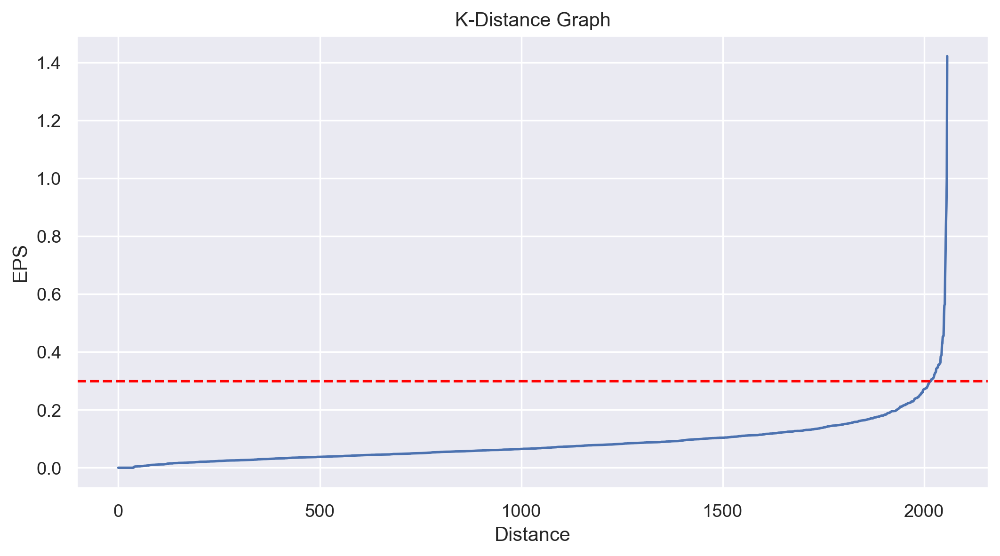

In [94]:
plt.plot(distance)
plt.axhline(y=0.3, linestyle = '--', color = 'red')
plt.xlabel('Distance')
plt.ylabel('EPS')
plt.title('K-Distance Graph')

In [95]:
#final model

In [96]:
db = DBSCAN(eps = 0.1, min_samples = 1)
y_pred = db.fit_predict(x)
y_pred

array([  0,   1,   2, ..., 422, 148,  78], dtype=int64)

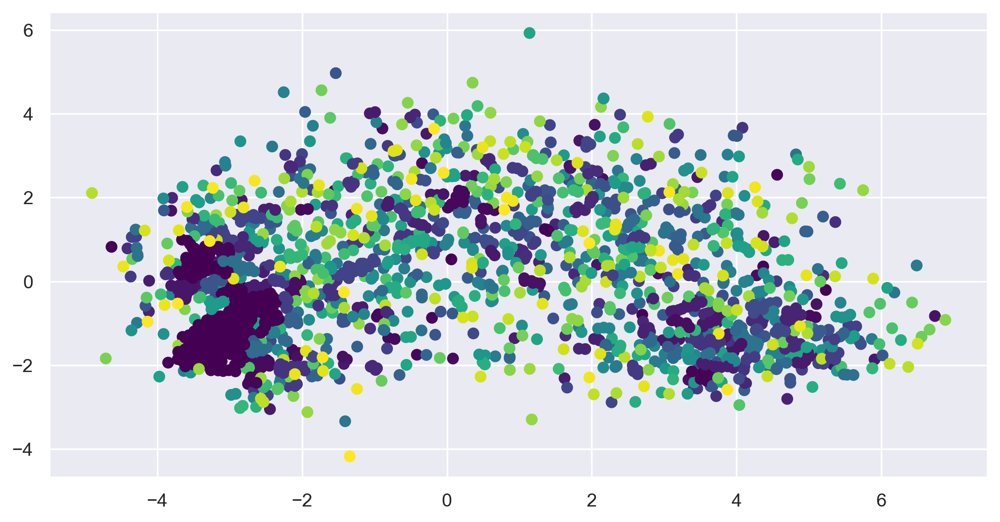

In [97]:
plt.scatter(x[:,0], x[:,1], c = y_pred, cmap = 'viridis')

In [98]:
silhouette_score(x,y_pred)

0.08855920869170002

In [99]:
df['cluster'].value_counts()

cluster
0    893
2    410
3    378
1    377
Name: count, dtype: int64

<Axes: ylabel='count'>

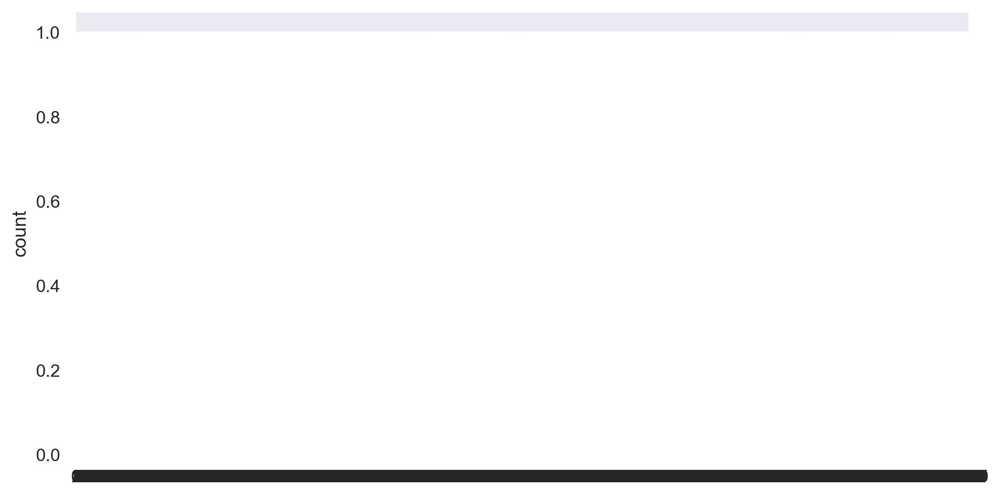

In [102]:
sns.countplot(df['cluster'])

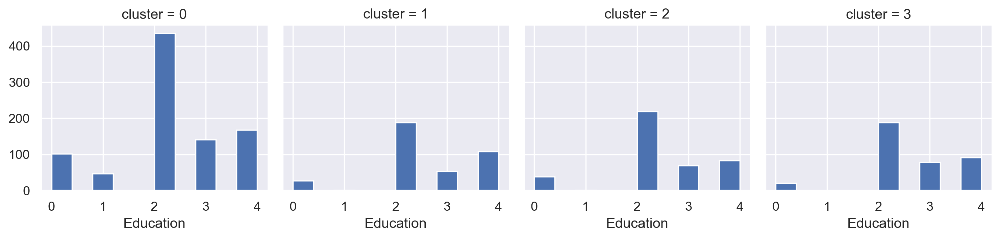

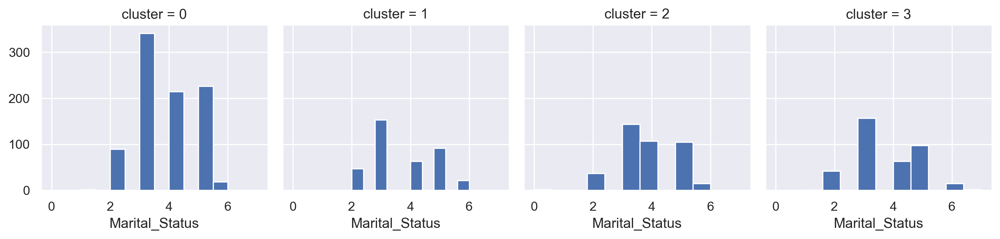

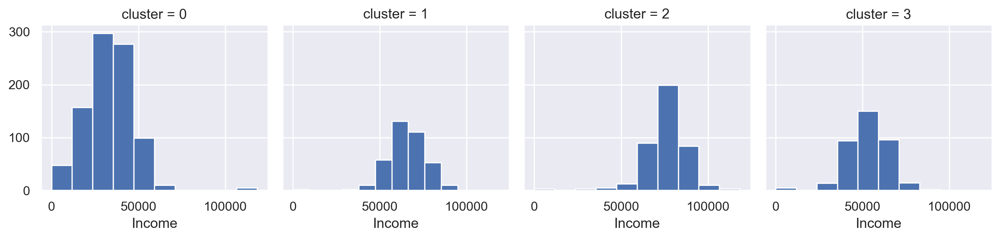

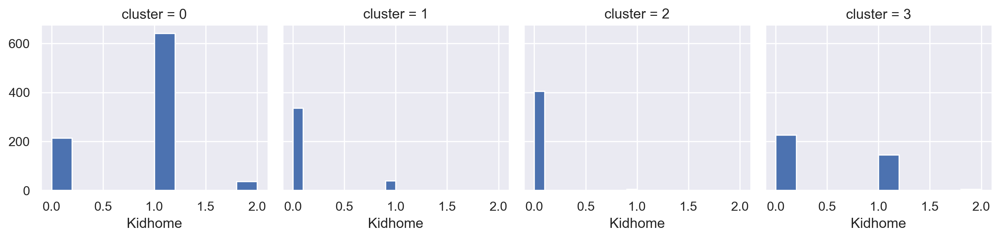

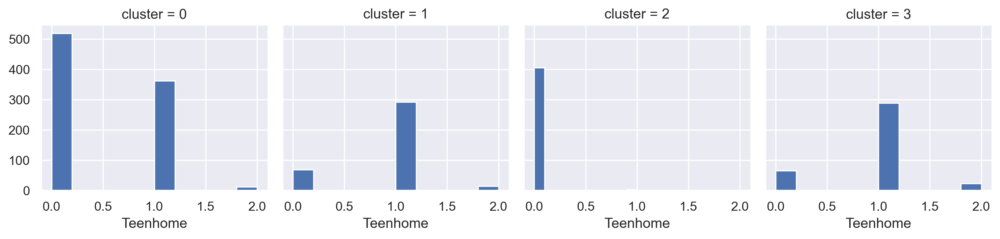

...

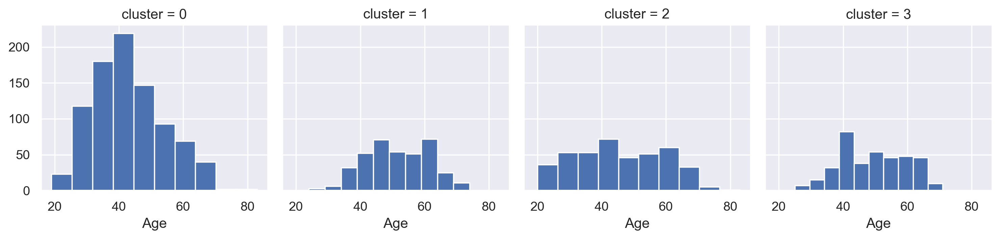

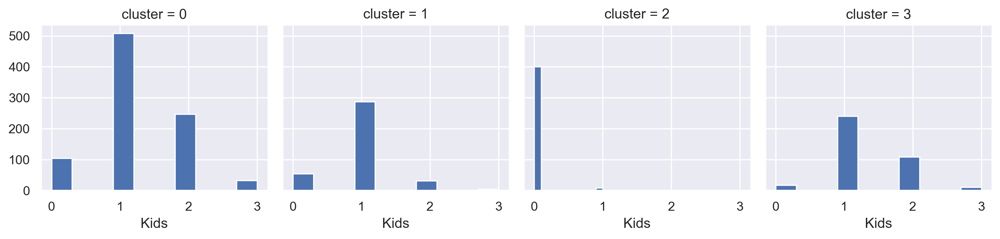

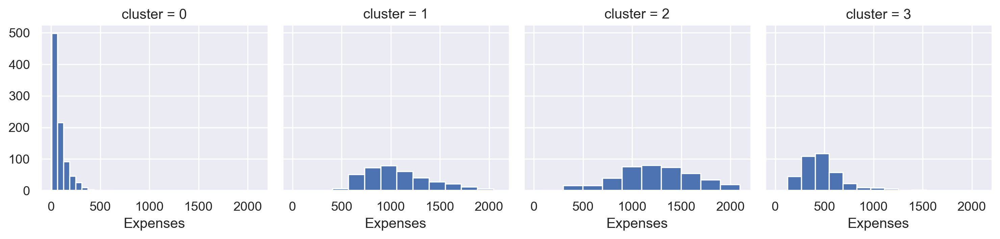

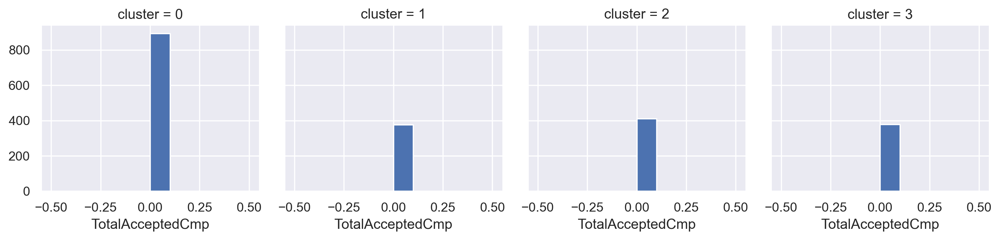

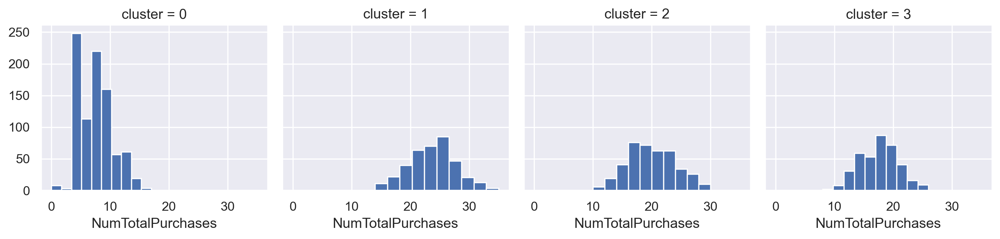

In [103]:
for c in df.drop(['cluster'], axis = 1):
    grid = sns.FacetGrid(df, col = 'cluster')
    grid = grid.map(plt.hist, c)
plt.show()

In [104]:
df.head()

,Education,Marital_Status,Income,Kidhome,Teenhome,Recency,MntWines,MntFruits,MntMeatProducts,MntFishProducts,MntSweetProducts,MntGoldProds,NumDealsPurchases,NumWebPurchases,NumCatalogPurchases,NumStorePurchases,NumWebVisitsMonth,AcceptedCmp3,AcceptedCmp4,AcceptedCmp5,AcceptedCmp1,AcceptedCmp2,Complain,Response,Age,Kids,Expenses,TotalAcceptedCmp,NumTotalPurchases,cluster
0,2,4,58138.0,0.0,0.0,58.0,635.0,81.0,546.0,120.5,82.875,88.0,3.0,8.0,10.0,4.0,7.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,58.0,0.0,1553.375,0.0,25.0,1
1,2,4,46344.0,1.0,1.0,38.0,11.0,1.0,6.0,2.0,1.000,6.0,2.0,1.0,1.0,2.0,5.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,61.0,2.0,27.000,0.0,6.0,0
2,2,5,71613.0,0.0,0.0,26.0,426.0,49.0,127.0,111.0,21.000,42.0,1.0,8.0,2.0,10.0,4.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,50.0,0.0,776.000,0.0,21.0,1
3,2,5,26646.0,1.0,0.0,26.0,11.0,4.0,20.0,10.0,3.000,5.0,2.0,2.0,0.0,4.0,6.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,31.0,1.0,53.000,0.0,8.0,0
4,4,3,58293.0,1.0,0.0,94.0,173.0,43.0,118.0,46.0,27.000,15.0,5.0,5.0,3.0,6.0,5.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,34.0,1.0,422.000,0.0,19.0,3


In [105]:
#Saving Scikitlearn models
import joblib
joblib.dump(km, "kmeans_model.pkl")

['kmeans_model.pkl']

In [106]:
df.to_csv("Clustered_Customer_Data.csv")

# Creating labels for supervised learning

In [107]:
# For demonstration, creating a random dataset
np.random.seed(42)
X = np.random.rand(100, 5)  # 100 samples, 5 features

# Perform K-means clustering with the optimal number of clusters
optimal_clusters = 4
kmeans = KMeans(n_clusters=optimal_clusters, init='k-means++', random_state=42)
cluster_labels = kmeans.fit_predict(X)

# Create a DataFrame with features and cluster labels
X_df = pd.DataFrame(X, columns=[f'feature_{i}' for i in range(X.shape[1])])
X_df['Cluster'] = cluster_labels

# Separate features (X) and cluster labels (y)
X = X_df.drop(columns=['Cluster'])  # Features excluding cluster labels
y = X_df['Cluster']  # Cluster labels

# Split data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Train a supervised learning model
clf = RandomForestClassifier(random_state=42)
clf.fit(X_train, y_train)

# Evaluate the model
y_pred = clf.predict(X_test)
accuracy = accuracy_score(y_test, y_pred)
print("Accuracy:", accuracy)

Accuracy: 0.9


In [108]:
df.head()

,Education,Marital_Status,Income,Kidhome,Teenhome,Recency,MntWines,MntFruits,MntMeatProducts,MntFishProducts,MntSweetProducts,MntGoldProds,NumDealsPurchases,NumWebPurchases,NumCatalogPurchases,NumStorePurchases,NumWebVisitsMonth,AcceptedCmp3,AcceptedCmp4,AcceptedCmp5,AcceptedCmp1,AcceptedCmp2,Complain,Response,Age,Kids,Expenses,TotalAcceptedCmp,NumTotalPurchases,cluster
0,2,4,58138.0,0.0,0.0,58.0,635.0,81.0,546.0,120.5,82.875,88.0,3.0,8.0,10.0,4.0,7.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,58.0,0.0,1553.375,0.0,25.0,1
1,2,4,46344.0,1.0,1.0,38.0,11.0,1.0,6.0,2.0,1.000,6.0,2.0,1.0,1.0,2.0,5.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,61.0,2.0,27.000,0.0,6.0,0
2,2,5,71613.0,0.0,0.0,26.0,426.0,49.0,127.0,111.0,21.000,42.0,1.0,8.0,2.0,10.0,4.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,50.0,0.0,776.000,0.0,21.0,1
3,2,5,26646.0,1.0,0.0,26.0,11.0,4.0,20.0,10.0,3.000,5.0,2.0,2.0,0.0,4.0,6.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,31.0,1.0,53.000,0.0,8.0,0
4,4,3,58293.0,1.0,0.0,94.0,173.0,43.0,118.0,46.0,27.000,15.0,5.0,5.0,3.0,6.0,5.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,34.0,1.0,422.000,0.0,19.0,3


# Automatic Model Building

In [109]:
def prediction(model):
    model.fit(X_train,y_train)
    yp = model.predict(X_test)
    print(f"Train Accuracy: {model.score(X_train,y_train)}")
    print(f"Test Accuracy: {model.score(X_test,y_test)}")
    print(classification_report(y_test,yp))

In [110]:
prediction(GradientBoostingClassifier())

Train Accuracy: 1.0
Test Accuracy: 0.85
              precision    recall  f1-score   support

           0       0.83      1.00      0.91         5
           1       0.78      1.00      0.88         7
           2       1.00      0.50      0.67         4
           3       1.00      0.75      0.86         4

    accuracy                           0.85        20
   macro avg       0.90      0.81      0.83        20
weighted avg       0.88      0.85      0.84        20



In [111]:
prediction(BaggingClassifier(estimator=LogisticRegression(), n_estimators=50))

Train Accuracy: 0.9375
Test Accuracy: 0.85
              precision    recall  f1-score   support

           0       0.62      1.00      0.77         5
           1       1.00      1.00      1.00         7
           2       1.00      0.75      0.86         4
           3       1.00      0.50      0.67         4

    accuracy                           0.85        20
   macro avg       0.91      0.81      0.82        20
weighted avg       0.91      0.85      0.85        20



In [112]:
prediction(KNeighborsClassifier())

Train Accuracy: 0.9125
Test Accuracy: 0.9
              precision    recall  f1-score   support

           0       0.71      1.00      0.83         5
           1       1.00      1.00      1.00         7
           2       1.00      0.75      0.86         4
           3       1.00      0.75      0.86         4

    accuracy                           0.90        20
   macro avg       0.93      0.88      0.89        20
weighted avg       0.93      0.90      0.90        20



In [113]:
prediction(BaggingClassifier(estimator=KNeighborsClassifier()))

Train Accuracy: 0.9125
Test Accuracy: 0.95
              precision    recall  f1-score   support

           0       0.83      1.00      0.91         5
           1       1.00      1.00      1.00         7
           2       1.00      0.75      0.86         4
           3       1.00      1.00      1.00         4

    accuracy                           0.95        20
   macro avg       0.96      0.94      0.94        20
weighted avg       0.96      0.95      0.95        20



In [114]:
prediction(BaggingClassifier(estimator=DecisionTreeClassifier(), n_estimators=10))

Train Accuracy: 1.0
Test Accuracy: 0.85
              precision    recall  f1-score   support

           0       0.83      1.00      0.91         5
           1       0.78      1.00      0.88         7
           2       1.00      0.50      0.67         4
           3       1.00      0.75      0.86         4

    accuracy                           0.85        20
   macro avg       0.90      0.81      0.83        20
weighted avg       0.88      0.85      0.84        20



In [115]:
prediction(XGBClassifier())

Train Accuracy: 1.0
Test Accuracy: 0.9
              precision    recall  f1-score   support

           0       0.83      1.00      0.91         5
           1       0.88      1.00      0.93         7
           2       1.00      0.50      0.67         4
           3       1.00      1.00      1.00         4

    accuracy                           0.90        20
   macro avg       0.93      0.88      0.88        20
weighted avg       0.91      0.90      0.89        20



In [116]:
prediction(SVC())

Train Accuracy: 0.9875
Test Accuracy: 0.9
              precision    recall  f1-score   support

           0       0.71      1.00      0.83         5
           1       1.00      1.00      1.00         7
           2       1.00      0.75      0.86         4
           3       1.00      0.75      0.86         4

    accuracy                           0.90        20
   macro avg       0.93      0.88      0.89        20
weighted avg       0.93      0.90      0.90        20



In [117]:
models = []

models.append(('lg',LogisticRegression()))
models.append(('dt',DecisionTreeClassifier()))
models.append(('dt1', DecisionTreeClassifier(criterion='entropy')))
models.append(('svc',SVC()))
models.append(('gb',GradientBoostingClassifier()))

In [118]:
models

[('lg', LogisticRegression()),
 ('dt', DecisionTreeClassifier()),
 ('dt1', DecisionTreeClassifier(criterion='entropy')),
 ('svc', SVC()),
 ('gb', GradientBoostingClassifier())]

In [119]:
prediction(StackingClassifier(estimators=models, final_estimator=RandomForestClassifier(max_depth=5)))

Train Accuracy: 0.9875
Test Accuracy: 0.95
              precision    recall  f1-score   support

           0       0.83      1.00      0.91         5
           1       1.00      1.00      1.00         7
           2       1.00      1.00      1.00         4
           3       1.00      0.75      0.86         4

    accuracy                           0.95        20
   macro avg       0.96      0.94      0.94        20
weighted avg       0.96      0.95      0.95        20



In [120]:
#Model is good and generalized.

In [121]:
transformer = ColumnTransformer(transformers=[
    ('Encoding', OneHotEncoder(),[0,1]),
    ('scaling',StandardScaler(),[2,5,6,8])
], remainder='passthrough')

In [122]:
xtrain,xtest,ytrain,ytest = train_test_split(df.drop(columns=['cluster']), df['cluster'], test_size=0.2,random_state=1)

In [123]:
xtrain

,Education,Marital_Status,Income,Kidhome,Teenhome,Recency,MntWines,MntFruits,MntMeatProducts,MntFishProducts,MntSweetProducts,MntGoldProds,NumDealsPurchases,NumWebPurchases,NumCatalogPurchases,NumStorePurchases,NumWebVisitsMonth,AcceptedCmp3,AcceptedCmp4,AcceptedCmp5,AcceptedCmp1,AcceptedCmp2,Complain,Response,Age,Kids,Expenses,TotalAcceptedCmp,NumTotalPurchases
573,4,5,64413.0,0.0,1.0,27.0,200.0,5.0,44.00,0.0,10.000,20.0,1.0,5.0,1.0,5.0,5.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,45.0,1.0,279.000,0.0,12.0
17,2,5,37760.0,0.0,0.0,20.0,84.0,5.0,38.00,120.5,12.000,28.0,2.0,4.0,1.0,6.0,7.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,69.0,0.0,287.500,0.0,13.0
250,3,4,31160.0,1.0,0.0,59.0,16.0,3.0,25.00,6.0,1.000,13.0,2.0,2.0,0.0,3.0,8.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,40.0,1.0,64.000,0.0,7.0
1874,2,2,49638.0,0.0,1.0,71.0,18.0,10.0,3.00,3.0,5.000,0.0,1.0,1.0,0.0,3.0,2.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,63.0,1.0,39.000,0.0,5.0
1493,2,5,57867.0,1.0,0.0,48.0,344.0,35.0,178.00,15.0,23.000,17.0,6.0,7.0,2.0,9.0,6.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,37.0,1.0,612.000,0.0,24.0
1828,3,3,80739.0,0.0,0.0,92.0,674.0,81.0,549.75,39.0,0.000,92.0,1.0,3.0,10.0,9.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,57.0,0.0,1435.750,0.0,23.0
2087,2,3,79823.0,0.0,1.0,6.0,835.0,73.0,380.00,114.0,73.000,43.0,1.0,6.0,9.0,7.0,2.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,56.0,1.0,1518.000,0.0,23.0
285,2,3,30631.0,1.0,0.0,75.0,15.0,6.0,20.00,4.0,5.000,20.0,1.0,3.0,1.0,2.0,7.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,41.0,1.0,70.000,0.0,7.0
1538,4,3,71969.0,0.0,1.0,59.0,1000.0,0.0,76.00,0.0,0.000,10.0,3.0,3.0,4.0,9.0,8.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,44.0,1.0,1086.000,0.0,19.0
1099,2,3,56775.0,0.0,1.0,62.0,614.0,35.0,160.00,58.0,35.000,35.0,2.0,5.0,8.0,10.0,5.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,36.0,1.0,937.000,0.0,25.0


In [124]:
Final_model = Pipeline(steps=[('transformer', transformer),('model',SVC())])

In [125]:
xtrain

,Education,Marital_Status,Income,Kidhome,Teenhome,Recency,MntWines,MntFruits,MntMeatProducts,MntFishProducts,MntSweetProducts,MntGoldProds,NumDealsPurchases,NumWebPurchases,NumCatalogPurchases,NumStorePurchases,NumWebVisitsMonth,AcceptedCmp3,AcceptedCmp4,AcceptedCmp5,AcceptedCmp1,AcceptedCmp2,Complain,Response,Age,Kids,Expenses,TotalAcceptedCmp,NumTotalPurchases
573,4,5,64413.0,0.0,1.0,27.0,200.0,5.0,44.00,0.0,10.000,20.0,1.0,5.0,1.0,5.0,5.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,45.0,1.0,279.000,0.0,12.0
17,2,5,37760.0,0.0,0.0,20.0,84.0,5.0,38.00,120.5,12.000,28.0,2.0,4.0,1.0,6.0,7.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,69.0,0.0,287.500,0.0,13.0
250,3,4,31160.0,1.0,0.0,59.0,16.0,3.0,25.00,6.0,1.000,13.0,2.0,2.0,0.0,3.0,8.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,40.0,1.0,64.000,0.0,7.0
1874,2,2,49638.0,0.0,1.0,71.0,18.0,10.0,3.00,3.0,5.000,0.0,1.0,1.0,0.0,3.0,2.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,63.0,1.0,39.000,0.0,5.0
1493,2,5,57867.0,1.0,0.0,48.0,344.0,35.0,178.00,15.0,23.000,17.0,6.0,7.0,2.0,9.0,6.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,37.0,1.0,612.000,0.0,24.0
1828,3,3,80739.0,0.0,0.0,92.0,674.0,81.0,549.75,39.0,0.000,92.0,1.0,3.0,10.0,9.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,57.0,0.0,1435.750,0.0,23.0
2087,2,3,79823.0,0.0,1.0,6.0,835.0,73.0,380.00,114.0,73.000,43.0,1.0,6.0,9.0,7.0,2.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,56.0,1.0,1518.000,0.0,23.0
285,2,3,30631.0,1.0,0.0,75.0,15.0,6.0,20.00,4.0,5.000,20.0,1.0,3.0,1.0,2.0,7.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,41.0,1.0,70.000,0.0,7.0
1538,4,3,71969.0,0.0,1.0,59.0,1000.0,0.0,76.00,0.0,0.000,10.0,3.0,3.0,4.0,9.0,8.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,44.0,1.0,1086.000,0.0,19.0
1099,2,3,56775.0,0.0,1.0,62.0,614.0,35.0,160.00,58.0,35.000,35.0,2.0,5.0,8.0,10.0,5.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,36.0,1.0,937.000,0.0,25.0


In [126]:
Final_model.fit(xtrain,ytrain)

Pipeline(steps=[('transformer',
                 ColumnTransformer(remainder='passthrough',
                                   transformers=[('Encoding', OneHotEncoder(),
                                                  [0, 1]),
                                                 ('scaling', StandardScaler(),
                                                  [2, 5, 6, 8])])),
                ('model', SVC())])

In [127]:
ypred = Final_model.predict(xtest)


In [128]:
import pickle
filename = 'svc_model.sav'
pickle.dump(Final_model, open(filename, 'wb'))
 
